In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
from datetime import timedelta
from dateutil.parser import parse
from datetime import datetime
from pandas.tseries.offsets import Hour, Minute
from pandas.tseries.offsets import Day, MonthEnd
import pytz
from pandas.tseries.offsets import Hour
from pandas.tseries.frequencies import to_offset

In [2]:
def visualize(data, bus, save):
    ##visualization by day of the year
    dates = pd.PeriodIndex(year=data.Year, month = data.Month ,day = data.Day, freq = "D")
    data['Date'] = dates
    new_data = data.groupby('Date').mean()
    fig1 = plt.figure()
    fig1.set_figwidth(15)
    new_data[bus].plot()
    
    if save == True:
        fig1.savefig('DayMeanPV')
    

In [3]:
def visualize_day(data, bus, freq, x, save):
    ##visualizes the x first days  and the x last days for the data frame data, bus bus, and of frequency of data collection freq.
    period  = pv.Period*freq 
    dates = pd.PeriodIndex(year=data.Year, month = data.Month,day = data.Day, minute = period, freq = "T")
    
    data['Date'] = dates
    new_data  = data.groupby('Date').sum()
    
    fig1 = plt.figure()
    fig1.set_figwidth (20)
    image_first_21 = new_data[bus].plot()
    image_first_21 = fig1.add_subplot(image_first_21)
    if save == True:
        fig1.savefig('PV')
    
    fig2 = plt.figure()
    fig2.set_figwidth (50)
    image_first_21 = new_data[bus].head(x).plot()
    image_first_21 = fig2.add_subplot(image_first_21)
    
    if save == True:
        fig2.savefig('PV_first_couple')
    
    fig3 = plt.figure()
    fig3.set_figwidth (50)
    image_last_21 = new_data[bus].tail(x).plot()
    image_last_21 = fig3.add_subplot(image_last_21)
    
    if save == True:
        fig3.savefig('PV_last_couple')
    #new_data = new_data.drop(['Year',"Month", 'Day', 'Period'],axis='columns')
    
    
    return new_data


In [4]:
def multidata_STL(model, df1):
    
    c = 0
    
    for col in df1.columns:
        if c==0:
            data = model.fit(df = df1.to_timestamp()[col]).resid.to_frame()
            c = 1
        else:
            series = model.fit(df = df1.to_timestamp()[col]).resid
            data[col] = series.values
            
    
    return data
        
        

    
    

In [5]:

pv = pd.read_csv('REAL_TIME_pv.csv')
print(pv)


        Year  Month  Day  Period  320_PV_1  314_PV_1  314_PV_2  313_PV_1  \
0       2020      1    1       1       0.0       0.0       0.0       0.0   
1       2020      1    1       2       0.0       0.0       0.0       0.0   
2       2020      1    1       3       0.0       0.0       0.0       0.0   
3       2020      1    1       4       0.0       0.0       0.0       0.0   
4       2020      1    1       5       0.0       0.0       0.0       0.0   
...      ...    ...  ...     ...       ...       ...       ...       ...   
105403  2020     12   31     284       0.0       0.0       0.0       0.0   
105404  2020     12   31     285       0.0       0.0       0.0       0.0   
105405  2020     12   31     286       0.0       0.0       0.0       0.0   
105406  2020     12   31     287       0.0       0.0       0.0       0.0   
105407  2020     12   31     288       0.0       0.0       0.0       0.0   

        314_PV_3  314_PV_4  ...  215_PV_1  102_PV_1  101_PV_1  102_PV_2  \
0           

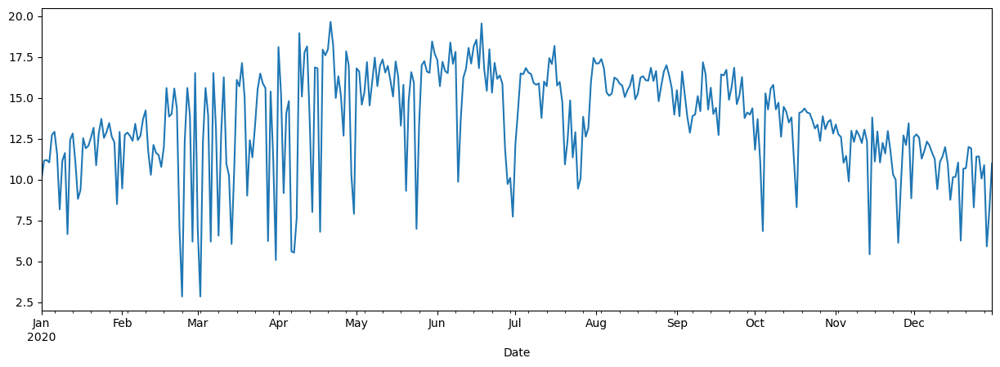

In [6]:
visualize(pv, '310_PV_1', False)

                  320_PV_1  314_PV_1  314_PV_2  313_PV_1  314_PV_3  314_PV_4  \
Date                                                                           
2020-01-01 00:15       0.0       0.0       0.0       0.0       0.0       0.0   
2020-01-01 00:30       0.0       0.0       0.0       0.0       0.0       0.0   
2020-01-01 00:45       0.0       0.0       0.0       0.0       0.0       0.0   
2020-01-01 01:00       0.0       0.0       0.0       0.0       0.0       0.0   
2020-01-01 01:15       0.0       0.0       0.0       0.0       0.0       0.0   
...                    ...       ...       ...       ...       ...       ...   
2020-12-31 23:00       0.0       0.0       0.0       0.0       0.0       0.0   
2020-12-31 23:15       0.0       0.0       0.0       0.0       0.0       0.0   
2020-12-31 23:30       0.0       0.0       0.0       0.0       0.0       0.0   
2020-12-31 23:45       0.0       0.0       0.0       0.0       0.0       0.0   
2021-01-01 00:00       0.0       0.0    

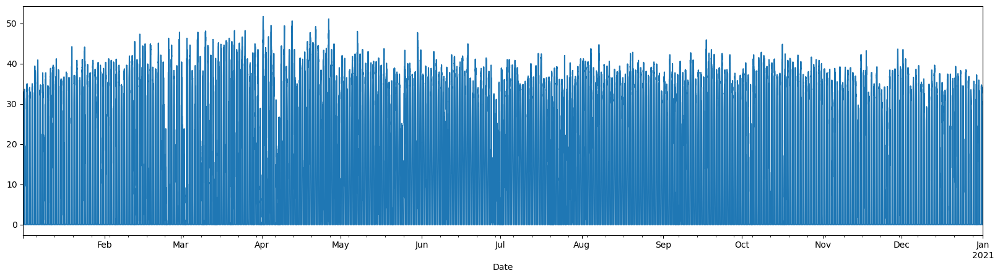

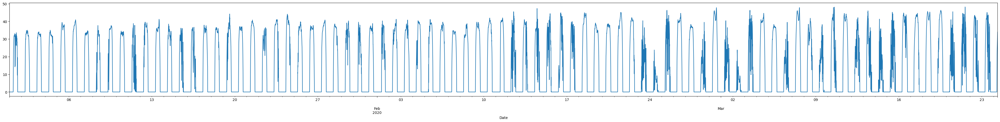

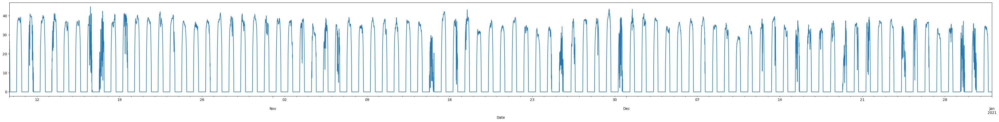

In [7]:
##visualization by every 5 minutes

new_pv = visualize_day(pv, '310_PV_1',5, 24000, False)
new_pv1 = new_pv.drop(['Year',"Month", 'Day', 'Period'],axis='columns')
new_pv1 = new_pv1.rolling(3).mean().loc[new_pv1.index.minute.isin([0, 15, 30, 45])]
new_pv2 = new_pv[['Year',"Month", 'Day', 'Period']].loc[new_pv.index.minute.isin([0, 15, 30, 45])]
new_pv = new_pv1
print(new_pv)


In [8]:
%cd ../

C:\Users\bvits\Downloads\Bachelor Thesis\Thesis Code\BachelorThesisRoland


In [9]:
from statsmodels.tsa.seasonal import seasonal_decompose
from src.decomposition.seasonal import STL, FourierDecomposition, MultiSeasonalDecomposition

In [10]:
stl = STL(seasonality_period=288, model = "additive")

In [11]:
pv_stl = stl.fit(df = new_pv.to_timestamp()['310_PV_1'])

In [12]:

#pv_stl.trend
#pv_stl.seasonal
#pv_stl.resid


In [13]:
pv_stl.plot()

In [14]:
ft = FourierDecomposition(seasonality_period="hour", model = "additive", n_fourier_terms=5)

In [15]:


pv_ft = ft.fit(new_pv['310_PV_1'].squeeze().to_timestamp())
#pv['310_PV_1'].squeeze(), index=new_pv.to_timestamp()['310_PV_1'].index

In [16]:
pv_ft.plot()

In [17]:
#df = pv_stl.resid.to_frame()

In [18]:
#df.to_csv('PV_deseason')

In [27]:
df = multidata_STL(stl,new_pv)
df.index = df.index.strftime('%Y-%m-%d %H:%M')
new_pv2.index = df.index
print(df)
df = df.join(new_pv2)
print(df)
#df.to_csv('PV_deseason_15_Dated')

                  320_PV_1  314_PV_1  314_PV_2  313_PV_1  314_PV_3  314_PV_4  \
Date                                                                           
2020-01-01 00:15  3.966453  3.980737  4.282982  7.276192  6.895283  4.207643   
2020-01-01 00:30  3.966107  3.980367  4.282545  7.275664  6.894732  4.207236   
2020-01-01 00:45  3.965761  3.979998  4.282108  7.275137  6.894181  4.206830   
2020-01-01 01:00  3.965415  3.979628  4.281671  7.274609  6.893630  4.206423   
2020-01-01 01:15  3.965069  3.979259  4.281233  7.274081  6.893079  4.206017   
...                    ...       ...       ...       ...       ...       ...   
2020-12-31 23:00  4.196272  4.337796  4.945785  7.998593  7.508227  4.885333   
2020-12-31 23:15  4.196673  4.338216  4.946257  7.999258  7.508839  4.885800   
2020-12-31 23:30  4.197074  4.338635  4.946729  7.999923  7.509451  4.886268   
2020-12-31 23:45  4.197475  4.339055  4.947201  8.000588  7.510062  4.886735   
2021-01-01 00:00  4.197876  4.339474  4.

In [28]:
df.to_csv('PV_deseason_15_Dated')